# 1. Intro to RDKit

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from rdkit import Chem  # Common functionality from RDKit is available in the Chem module
from rdkit.Chem import AllChem  # Most of the other functions are in AllChem and other modules
import pandas as pd
import numpy as np
import gzip
import json

In [ ]:
data_path = 'qm9.json'
with open(data_path, 'rt') as fp:  # read in text format
    record = fp.readline().strip()  # strip whitespace
print(record)

{"A":2.5832,"B":1.30797,"C":0.93888,"R2":1313.6519,"alpha":89.34,"atomic_charges":[-0.499654,0.225168,0.200368,-0.291577,-0.21091,-0.28294,-0.105237,-0.239277,-0.322535,0.124266,0.121383,0.129916,0.102653,0.100871,0.096362,0.101769,0.097331,0.102152,0.095926,0.11547,0.111787,0.226708],"bandgap":0.2487,"cv":34.347,"filename":"dsgdb9nsd_073931.xyz","g":-367.242047,"g4mp2_0k":-366.761358,"g4mp2_atom":-3.347687,"g4mp2_energy":-366.752131,"g4mp2_enthalpy":-366.751186,"g4mp2_free":-366.795572,"g4mp2_hf298":33.0693,"g4mp2_zpe":0.192623,"h":-367.197822,"homo":-0.2266,"inchi_0":"InChI=1S\/C8H13N\/c1-6-3-2-4-7(6)8-5-9-8\/h8-9H,2-5H2,1H3","inchi_1":"InChI=1S\/C8H13N\/c1-6-3-2-4-7(6)8-5-9-8\/h8-9H,2-5H2,1H3\/t8-\/m1\/s1","index":73931,"lumo":0.0221,"mu":1.8965,"n_atom":22,"n_electrons":68,"n_heavy_atoms":9,"smiles_0":"CC1=C(CCC1)C1CN1","smiles_1":"CC1=C(CCC1)[C@H]1CN1","u":-367.198766,"u0":-367.2079,"u0_atom":-3.346314,"xyz":"22\nProperties=species:S:1:pos:R:3 unique_id=ef4cdf48825f07674198527d13d

In [ ]:
json.loads(record)

{'A': 2.5832,
 'B': 1.30797,
 'C': 0.93888,
 'R2': 1313.6519,
 'alpha': 89.34,
 'atomic_charges': [-0.499654,
  0.225168,
  0.200368,
  -0.291577,
  -0.21091,
  -0.28294,
  -0.105237,
  -0.239277,
  -0.322535,
  0.124266,
  0.121383,
  0.129916,
  0.102653,
  0.100871,
  0.096362,
  0.101769,
  0.097331,
  0.102152,
  0.095926,
  0.11547,
  0.111787,
  0.226708],
 'bandgap': 0.2487,
 'cv': 34.347,
 'filename': 'dsgdb9nsd_073931.xyz',
 'g': -367.242047,
 'g4mp2_0k': -366.761358,
 'g4mp2_atom': -3.347687,
 'g4mp2_energy': -366.752131,
 'g4mp2_enthalpy': -366.751186,
 'g4mp2_free': -366.795572,
 'g4mp2_hf298': 33.0693,
 'g4mp2_zpe': 0.192623,
 'h': -367.197822,
 'homo': -0.2266,
 'inchi_0': 'InChI=1S/C8H13N/c1-6-3-2-4-7(6)8-5-9-8/h8-9H,2-5H2,1H3',
 'inchi_1': 'InChI=1S/C8H13N/c1-6-3-2-4-7(6)8-5-9-8/h8-9H,2-5H2,1H3/t8-/m1/s1',
 'index': 73931,
 'lumo': 0.0221,
 'mu': 1.8965,
 'n_atom': 22,
 'n_electrons': 68,
 'n_heavy_atoms': 9,
 'smiles_0': 'CC1=C(CCC1)C1CN1',
 'smiles_1': 'CC1=C(CCC1)[C

In [ ]:
data = pd.read_json(data_path, lines=True).head(1000)

In [ ]:
data[['smiles_0', 'inchi_0', 'u']].head(5)

,smiles_0,inchi_0,u
0,CC1=C(CCC1)C1CN1,"InChI=1S/C8H13N/c1-6-3-2-4-7(6)8-5-9-8/h8-9H,2...",-367.198766
1,COC12CCC1C1CC21,InChI=1S/C8H12O/c1-9-8-3-2-6(8)5-4-7(5)8/h5-7H...,-387.016378
2,OC1CC2CC12,"InChI=1S/C5H8O/c6-5-2-3-1-4(3)5/h3-6H,1-2H2",-270.390923
3,CC1C2CCC1C1CC21,"InChI=1S/C9H14/c1-5-6-2-3-7(5)9-4-8(6)9/h5-9H,...",-351.155574
4,COC12CC(C1C)C2=O,"InChI=1S/C7H10O2/c1-4-5-3-7(4,9-2)6(5)8/h4-5H,...",-422.975002


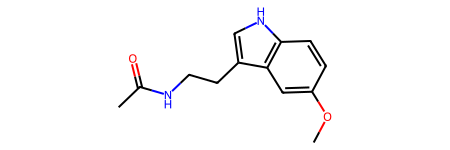

In [ ]:
m = Chem.MolFromSmiles('CC(=O)NCCC1=CNc2c1cc(OC)cc2')
m

In [ ]:
data['mol'] = data['smiles_0'].map(Chem.MolFromSmiles)
data['mol'].head(5)

0    <rdkit.Chem.rdchem.Mol object at 0x14147fdf0>
1    <rdkit.Chem.rdchem.Mol object at 0x14147fd80>
2    <rdkit.Chem.rdchem.Mol object at 0x14147fd10>
3    <rdkit.Chem.rdchem.Mol object at 0x14147fe60>
4    <rdkit.Chem.rdchem.Mol object at 0x14147fed0>
Name: mol, dtype: object

In [ ]:
for i, a in enumerate(m.GetAtoms()):
    print(f'Atom {i} is an {a.GetSymbol()}')

Atom 0 is an C
Atom 1 is an C
Atom 2 is an O
Atom 3 is an N
Atom 4 is an C
Atom 5 is an C
Atom 6 is an C
Atom 7 is an C
Atom 8 is an N
Atom 9 is an C
Atom 10 is an C
Atom 11 is an C
Atom 12 is an C
Atom 13 is an O
Atom 14 is an C
Atom 15 is an C
Atom 16 is an C


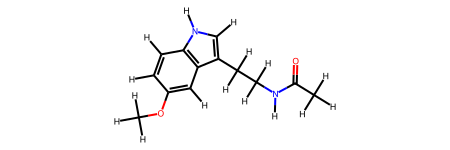

In [ ]:
mol = Chem.AddHs(m) # Add implicit hydrogens
mol

In [ ]:
for i, a in enumerate(mol.GetAtoms()):
    print(f'Atom {i} is an {a.GetSymbol()}')

Atom 0 is an C
Atom 1 is an C
Atom 2 is an O
Atom 3 is an N
Atom 4 is an C
Atom 5 is an C
Atom 6 is an C
Atom 7 is an C
Atom 8 is an N
Atom 9 is an C
Atom 10 is an C
Atom 11 is an C
Atom 12 is an C
Atom 13 is an O
Atom 14 is an C
Atom 15 is an C
Atom 16 is an C
Atom 17 is an H
Atom 18 is an H
Atom 19 is an H
Atom 20 is an H
Atom 21 is an H
Atom 22 is an H
Atom 23 is an H
Atom 24 is an H
Atom 25 is an H
Atom 26 is an H
Atom 27 is an H
Atom 28 is an H
Atom 29 is an H
Atom 30 is an H
Atom 31 is an H
Atom 32 is an H


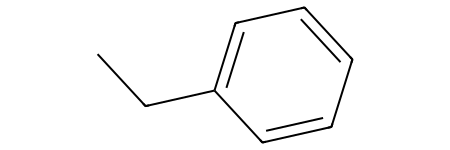

In [ ]:
toluene = Chem.MolFromSmiles('CCc1ccccc1')
toluene

In [ ]:
r = toluene.GetRingInfo()
print(f'Toluene has {r.NumRings()} ring')
print(f'Toluene has {AllChem.CalcNumRotatableBonds(toluene)} rotatable bonds') # rotatable bond descriptor

Toluene has 1 ring
Toluene has 1 rotatable bonds


# 2. Intro to descriptor-based ML

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LassoCV
from sklearn.metrics import r2_score, mean_absolute_error
from mordred import Calculator, descriptors
from rdkit import Chem
import pandas as pd
import numpy as np

In [ ]:
data['mol'] = data['smiles_0'].apply(Chem.MolFromSmiles)

In [ ]:
calc = Calculator(descriptors, ignore_3D=True)

In [ ]:
print(f'First 10 out of {len(calc.descriptors)} descriptors')
calc.descriptors[:10]

First 10 out of 1613 descriptors


(mordred.ABCIndex.ABCIndex(),
 mordred.ABCIndex.ABCGGIndex(),
 mordred.AcidBase.AcidicGroupCount(),
 mordred.AcidBase.BasicGroupCount(),
 mordred.AdjacencyMatrix.AdjacencyMatrix('SpAbs'),
 mordred.AdjacencyMatrix.AdjacencyMatrix('SpMax'),
 mordred.AdjacencyMatrix.AdjacencyMatrix('SpDiam'),
 mordred.AdjacencyMatrix.AdjacencyMatrix('SpAD'),
 mordred.AdjacencyMatrix.AdjacencyMatrix('SpMAD'),
 mordred.AdjacencyMatrix.AdjacencyMatrix('LogEE'))

In [ ]:
desc = calc.pandas(data['mol'])

100%|██████████| 1000/1000 [00:06<00:00, 154.53it/s]


In [ ]:
print(f'Computed {len(desc.columns)} descriptors for {len(desc)} molecules')

Computed 1613 descriptors for 1000 molecules


### Feature selection

In [ ]:
# First get only numeric columns
numeric_cols = desc.select_dtypes(include=['int64', 'float64']).columns

# Then find columns with zero standard deviation using describe
stats = desc[numeric_cols].describe()
zero_std_cols = stats.columns[stats.loc['std'] == 0]

# Print the column names
print("Columns with zero standard deviation:", list(zero_std_cols))

print(f'{len(zero_std_cols)} ({len(zero_std_cols) / len(desc.columns) *100:.1f}% features are constant for the dataset.)')

# To see the constant values in these columns
if len(zero_std_cols) > 0:
    print("\nConstant values:")
    for col in zero_std_cols:
        print(f"{col}: {desc[col].iloc[0]}")

Columns with zero standard deviation: ['nB', 'nS', 'nP', 'nCl', 'nBr', 'nI', 'NsLi', 'NssBe', 'NssssBe', 'NssBH', 'NsssB', 'NssssB', 'NdCH2', 'NddC', 'NsNH3', 'NsssNH', 'NssssN', 'NsSiH3', 'NssSiH2', 'NsssSiH', 'NssssSi', 'NsPH2', 'NssPH', 'NsssP', 'NdsssP', 'NsssssP', 'NsSH', 'NdS', 'NssS', 'NaaS', 'NdssS', 'NddssS', 'NsCl', 'NsGeH3', 'NssGeH2', 'NsssGeH', 'NssssGe', 'NsAsH2', 'NssAsH', 'NsssAs', 'NsssdAs', 'NsssssAs', 'NsSeH', 'NdSe', 'NssSe', 'NaaSe', 'NdssSe', 'NddssSe', 'NsBr', 'NsSnH3', 'NssSnH2', 'NsssSnH', 'NssssSn', 'NsI', 'NsPbH3', 'NssPbH2', 'NsssPbH', 'NssssPb', 'SsLi', 'SssBe', 'SssssBe', 'SssBH', 'SsssB', 'SssssB', 'SdCH2', 'SddC', 'SsNH3', 'SsssNH', 'SssssN', 'SsSiH3', 'SssSiH2', 'SsssSiH', 'SssssSi', 'SsPH2', 'SssPH', 'SsssP', 'SdsssP', 'SsssssP', 'SsSH', 'SdS', 'SssS', 'SaaS', 'SdssS', 'SddssS', 'SsCl', 'SsGeH3', 'SssGeH2', 'SsssGeH', 'SssssGe', 'SsAsH2', 'SssAsH', 'SsssAs', 'SsssdAs', 'SsssssAs', 'SsSeH', 'SdSe', 'SssSe', 'SaaSe', 'SdssSe', 'SddssSe', 'SsBr', 'SsSnH3'

In [ ]:
desc.drop(columns=zero_std_cols, inplace=True)
print(f'New shape: {desc.shape}')

New shape: (1000, 1417)


In [ ]:
for c in desc.columns:
    desc[c] = pd.to_numeric(desc[c], errors='coerce')

In [ ]:
missing_values = desc.isnull().any()
print(f'Found {missing_values.sum()} columns with missing values')

Found 385 columns with missing values


In [ ]:
desc = desc.loc[:, ~missing_values]  # Gets only columns that do not (~ means not) have missing values
print(f'New shape: {desc.shape}')

New shape: (1000, 1032)


Standardize data as you can see below - there is large variation

In [ ]:
desc.sample(8, axis=1).describe()

,VSA_EState5,GATS4s,GATS2c,VR1_Dzare,NdssC,SpMax_Dzv,ABCGG,SpMAD_Dzv
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000
mean,0.935445,1.172136,1.061256,30.527959,0.39100,19.303659,6.862680,4.406278
std,1.592334,0.389453,0.302209,3.778371,0.58691,3.288780,0.714145,0.667169
min,-2.582778,0.000000,0.223161,17.541382,0.00000,8.815401,4.785854,2.899852
25%,0.000000,0.914028,0.830563,28.795260,0.00000,17.275214,6.371088,3.954814
50%,0.296296,1.163654,1.067870,30.482472,0.00000,18.977583,6.824930,4.305162
75%,1.363148,1.396451,1.268512,32.899019,1.00000,21.024376,7.335178,4.743090
max,9.576165,2.892088,2.149126,40.334312,3.00000,31.898244,8.980827,7.108202


In [ ]:
scaler = StandardScaler()
feats = scaler.fit_transform(desc) # holds onto means and scales of each feature

In [ ]:
feats[:, :8].mean(axis=0), feats[:, :8].std(axis=0)  # can see data is standardized

(array([-5.77315973e-17, -3.58824082e-16, -3.19744231e-17,  2.13162821e-17,
        -7.99360578e-17,  2.30748753e-15,  2.29860575e-15, -1.05693232e-16]),
 array([1., 1., 1., 1., 1., 1., 1., 1.]))

Now we want to deal with strongly correlated variables to prevent overfitting

In [ ]:
cross_corr = np.corrcoef(feats.T) # transpose to get feature-feature correlation

Text(0.5, 0, 'Descriptor ID')

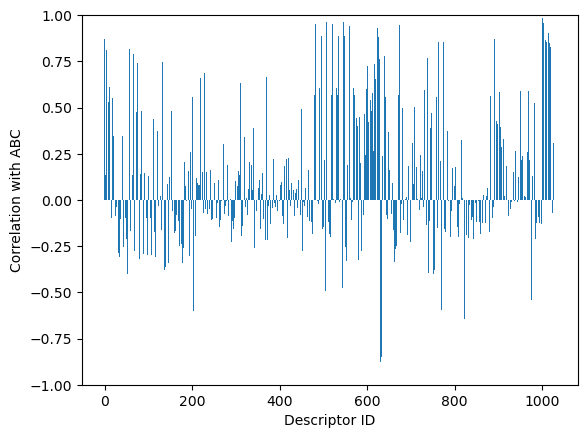

In [ ]:
fig, ax = plt.subplots()

ax.bar(range(len(cross_corr)-1), cross_corr[0, 1:])

ax.set_ylim(-1, 1)
ax.set_ylabel(f'Correlation with {desc.columns[0]}')
ax.set_xlabel('Descriptor ID')

In [ ]:
pca = PCA().fit(feats) # PCA creates new set of features that are linear combinations of original features

Text(0, 0.5, 'Explained Variance')

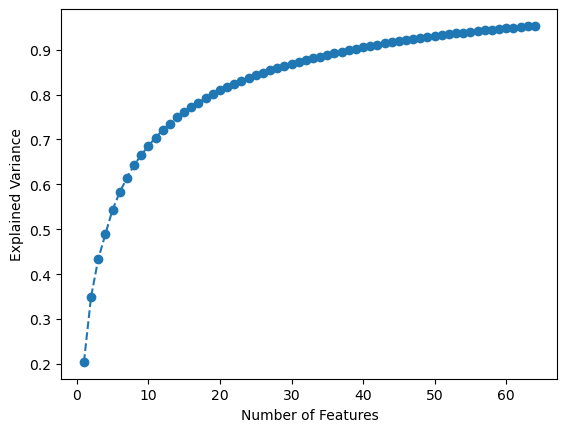

In [ ]:
fig, ax = plt.subplots()

num_features = 64
ax.plot(1 + np.arange(num_features),
           np.cumsum(pca.explained_variance_ratio_)[:num_features], 'o--')

ax.set_xlabel('Number of Features')
ax.set_ylabel('Explained Variance')

In [ ]:
pca.n_components = 16
pca_feats = pca.fit_transform(feats) # mutually orthogonal features

In [ ]:
cross_corr = np.corrcoef(pca_feats.T)
print(f'The largest correlation between feature 0 and all others is {max(cross_corr[0, 1:]):.2e}')

The largest correlation between feature 0 and all others is 6.91e-17


Then we need to select features that correlate strongly with the variable

In [ ]:
feat_score = [np.corrcoef(data['bandgap'], f)[0][1] for f in pca_feats.T]

Text(0.5, 0, 'Feature ID')

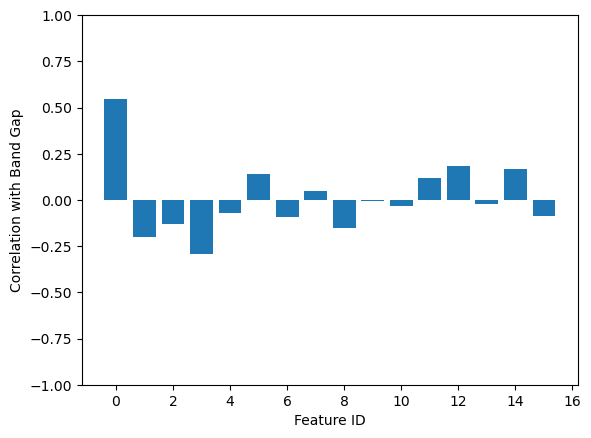

In [ ]:
fig, ax = plt.subplots()

ax.bar(range(len(feat_score)), feat_score)

ax.set_ylim(-1, 1)
ax.set_ylabel(f'Correlation with Band Gap')
ax.set_xlabel('Feature ID')

Use LASSO feature selection to choose relevant features to the data being modelled.

In [ ]:
lasso = LassoCV().fit(pca_feats, data['bandgap'])

Text(0.5, 0, 'Feature ID')

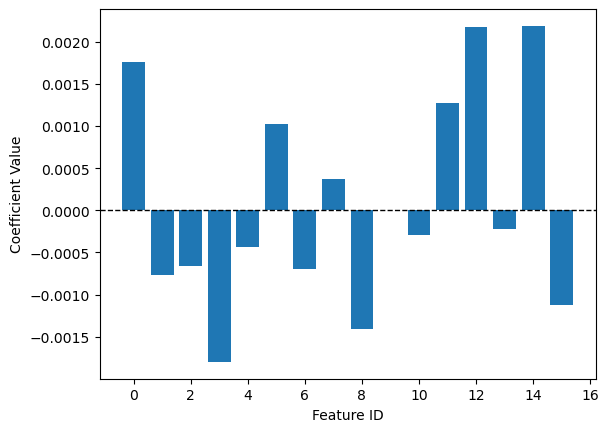

In [ ]:
fig, ax = plt.subplots()

ax.bar(range(len(feat_score)), lasso.coef_)
ax.set_xlim(ax.get_xlim())
ax.plot(ax.get_xlim(), [0, 0], 'k--', lw=1.)

ax.set_ylabel(f'Coefficient Value')
ax.set_xlabel('Feature ID')

In [ ]:
train_data, test_data, train_desc, test_desc = train_test_split(data, desc, test_size=0.1)

In [ ]:
model = Pipeline([
    ('scale', StandardScaler()),
    ('pca', PCA(n_components=16)),
    ('lasso', LassoCV())
])

In [ ]:
model.fit(train_desc, train_data['bandgap'])

Pipeline(steps=[('scale', StandardScaler()), ('pca', PCA(n_components=16)),
                ('lasso', LassoCV())])

In [ ]:
model.predict(test_desc);

In [ ]:
test_data = test_data.copy()  # Avoids some pandas issues
test_data['16-ncomp-model'] = model.fit(train_desc, train_data['bandgap']).predict(test_desc)

In [ ]:
model.set_params(pca__n_components=8)

Pipeline(steps=[('scale', StandardScaler()), ('pca', PCA(n_components=8)),
                ('lasso', LassoCV())])

In [ ]:
test_data['8-ncomp-model'] = model.fit(train_desc, train_data['bandgap']).predict(test_desc)

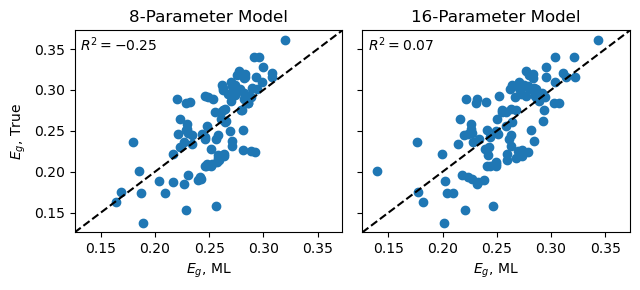

In [ ]:
fig, axs = plt.subplots(1, 2, sharey=True, figsize=(6.5, 3.))

# Plot both models
for ax, col in zip(axs, ['8-ncomp-model', '16-ncomp-model']):
    ax.set_title(f'{col.split("-")[0]}-Parameter Model')
    r2 = r2_score(test_data[col], test_data['bandgap'])
    ax.text(0.02, 0.9, f'$R^2 = {r2:.2f}$', transform=ax.transAxes)
    ax.scatter(test_data[col], test_data['bandgap'])

# Make it look nicer
for ax in axs:
    ax.set_xlabel('$E_g$, ML')
    
    ax.set_ylim(ax.get_ylim())
    ax.set_xlim(ax.get_ylim())
    ax.plot(ax.get_xlim(), ax.get_xlim(), 'k--')
    
axs[0].set_ylabel('$E_g$, True')
fig.tight_layout()

# 3. Fingerprint-based ML

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.base import BaseEstimator, TransformerMixin
from rdkit.Chem import AllChem
from rdkit import DataStructs
from rdkit import Chem
from tqdm import tqdm
import pandas as pd
import numpy as np

In [ ]:
data = pd.read_json('qm9.json', lines=True).sample(5000)

In [ ]:
from rdkit.Chem import rdFingerprintGenerator

In [ ]:
def compute_morgan_fingerprints_newvers(smiles: str, fingerprint_length: int, fingerprint_radius: int):
    """Get Morgan Fingerprint of a specific SMILES string.
    Adapted from: <https://github.com/google-research/google-research/blob/
    dfac4178ccf521e8d6eae45f7b0a33a6a5b691ee/mol_dqn/chemgraph/dqn/deep_q_networks.py#L750>
    Args:
      graph (str): The molecule as a SMILES string
      fingerprint_length (int): Bit-length of fingerprint
      fingerprint_radius (int): Radius used to compute fingerprint
    Returns:
      np.array. shape = [hparams, fingerprint_length]. The Morgan fingerprint.
    """
    # Initialize the fingerprint generator
    mfpgen = rdFingerprintGenerator.GetMorganGenerator(fingerprint_radius, fingerprint_length)

    # Parse the molecule
    molecule = Chem.MolFromSmiles(smiles)

    # Compute the fingerprint
    fingerprint = mfpgen.GetFingerprint(
        molecule)
    arr = np.zeros((1,), dtype=bool)

    # ConvertToNumpyArray takes ~ 0.19 ms, while
    # np.asarray takes ~ 4.69 ms
    DataStructs.ConvertToNumpyArray(fingerprint, arr)
    return arr

IndentationError: unexpected indent (1799640899.py, line 2)

In [ ]:
def compute_morgan_fingerprints(smiles: str, fingerprint_length: int, fingerprint_radius: int):
    """Get Morgan Fingerprint of a specific SMILES string.
    Adapted from: <https://github.com/google-research/google-research/blob/
    dfac4178ccf521e8d6eae45f7b0a33a6a5b691ee/mol_dqn/chemgraph/dqn/deep_q_networks.py#L750>
    Args:
      graph (str): The molecule as a SMILES string
      fingerprint_length (int): Bit-length of fingerprint
      fingerprint_radius (int): Radius used to compute fingerprint
    Returns:
      np.array. shape = [hparams, fingerprint_length]. The Morgan fingerprint.
    """
    # Parse the molecule
    molecule = Chem.MolFromSmiles(smiles)

    # Compute the fingerprint
    fingerprint = AllChem.GetMorganFingerprintAsBitVect(
        molecule, fingerprint_radius, fingerprint_length)
    arr = np.zeros((1,), dtype=bool)

    # ConvertToNumpyArray takes ~ 0.19 ms, while
    # np.asarray takes ~ 4.69 ms
    DataStructs.ConvertToNumpyArray(fingerprint, arr)
    return arr

In [ ]:
compute_morgan_fingerprints('C', 4, 2) # methane example

[11:56:07] DEPRECATION WARNING: please use MorganGenerator


array([ True, False, False, False])

In [ ]:
class MorganFingerprintTransformer(BaseEstimator, TransformerMixin):
    """Class that converts SMILES strings to fingerprint vectors"""
    
    def __init__(self, length: int = 256, radius: int = 4):
        self.length = length
        self.radius = radius
    
    def fit(self, X, y=None):
        return self  # Do need to do anything
    
    def transform(self, X, y=None):
        """Compute the fingerprints
        
        Args:
            X: List of SMILES strings
        Returns:
            Array of fingerprints
        """
        
        fing = [compute_morgan_fingerprints(m, self.length, self.radius) for m in X]
        return np.vstack(fing)
m = MorganFingerprintTransformer(4, 4)
m.transform(['C', 'CCC', 'C=O'])

[11:56:34] DEPRECATION WARNING: please use MorganGenerator
[11:56:34] DEPRECATION WARNING: please use MorganGenerator
[11:56:34] DEPRECATION WARNING: please use MorganGenerator


array([[ True, False, False, False],
       [ True,  True,  True, False],
       [ True, False,  True, False]])

In [ ]:
train_data, test_data = train_test_split(data)

In [ ]:
m.length = 256
test_fng = m.transform(test_data['smiles_0'])
train_fng = m.transform(train_data['smiles_0'])

[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerator
[12:35:12] DEPRECATION WARNING: please use MorganGenerat

In [ ]:
krr = KNeighborsRegressor(n_neighbors=3, metric='jaccard')

In [ ]:
krr.fit(train_fng, train_data['bandgap'])

KNeighborsRegressor(metric='jaccard', n_neighbors=3)

In [ ]:
y_pred = krr.predict(test_fng)

Text(0, 0.5, '$E_g$, True')

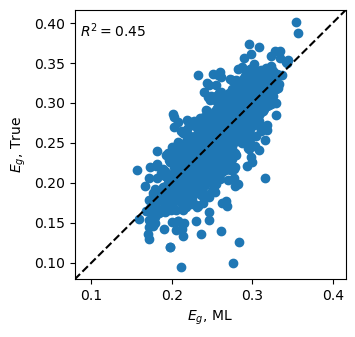

In [ ]:
fig, ax = plt.subplots(figsize=(3.5, 3.5))

r2 = r2_score(y_pred, test_data['bandgap'])
ax.text(0.02, 0.9, f'$R^2 = {r2:.2f}$', transform=ax.transAxes)
ax.scatter(y_pred, test_data['bandgap'])

ax.set_xlabel('$E_g$, ML')  
ax.set_ylim(ax.get_ylim())
ax.set_xlim(ax.get_ylim())
ax.plot(ax.get_xlim(), ax.get_xlim(), 'k--')
    
ax.set_ylabel('$E_g$, True')

In [ ]:
model = Pipeline([
    ('fingerprint', MorganFingerprintTransformer()),
    ('knn', KNeighborsRegressor(n_neighbors=2, metric='jaccard', n_jobs=-1))  # n_jobs = -1 lets the model run all available processors
])

In [ ]:
# A common pattern of work in ML is to try a few variations of parameters
#  and assess their performance. I prefer to use a pattern where I loop
#  over all of those parameters and then store them as a Pandas DataFrame.
#  You'll see how to do that in this cell
results = []
for l in [32, 64, 128]:
    model.set_params(fingerprint__length=l)
    for s in tqdm([3, 10, 30, 100, 300, 1000, 3000], desc=f'l={l}'):  # Loop over different training set sizes
        for i in range(16):  # Repeat the experiment
            subset = train_data.sample(s)  # Downselect to the desired size

            # Train and test the model
            model.fit(subset['smiles_0'], subset['bandgap'])
            y_pred = model.predict(test_data['smiles_0'])

            # Store the results
            #  Use a list of dictionaries, which I can convert to 
            #  a DataFrame very easily
            results.append({
                'length': l,
                'train_size': s,
                'iteration': i,
                'r2_score': r2_score(test_data['bandgap'], y_pred),
                'mae': mean_absolute_error(test_data['bandgap'], y_pred)
            })
results = pd.DataFrame(results)  # Converts to a dataframe

l=32:   0%|          | 0/7 [00:00<?, ?it/s][12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DEPRECATION WARNING: please use MorganGenerator
[12:50:29] DE

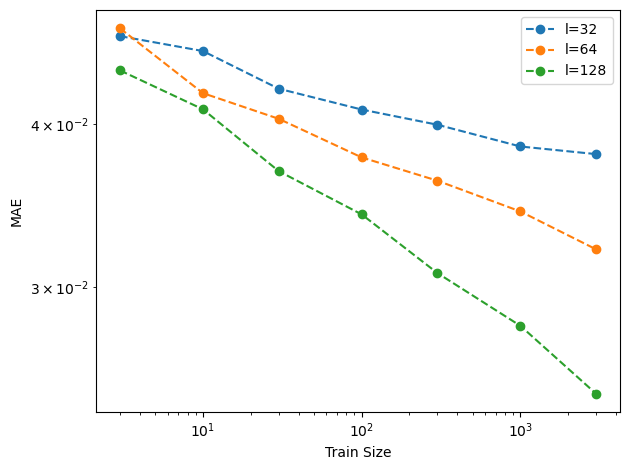

In [ ]:
fig, ax = plt.subplots()

# Group loops over subsets with the same value for
#  a certain column. "gid" is that value, and group
#  is a DataFrame with that population of data
for gid, group in results.groupby('length'):
    # First, group by the training set size and compute the average over averages
    #  The data is already grouped by length, so here we just need to compute the 
    #  average for all groups with the same training set size
    #
    #  You can do that in one line with Pandas:
    #  https://pandas.pydata.org/pandas-docs/stable/user_guide/groupby.html
    group_stats = group.groupby('train_size').mean()
    
    ax.loglog(group_stats.index, group_stats['mae'], '--o', label=f'l={gid}')
    
ax.legend()

ax.set_xlabel('Train Size')
ax.set_ylabel('MAE')
fig.tight_layout()

# 4. Assignment

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score, mean_absolute_error
from sklearn.base import BaseEstimator, TransformerMixin
from rdkit.Chem import AllChem
from rdkit import DataStructs
from rdkit import Chem
from tqdm import tqdm
import pandas as pd
import numpy as np

In [ ]:
data = pd.read_json('qm9.json', lines=True)

In [ ]:
data.head()

,A,B,C,R2,alpha,atomic_charges,bandgap,cv,filename,g,...,n_electrons,n_heavy_atoms,smiles_0,smiles_1,u,u0,u0_atom,xyz,zpe,in_holdout
0,2.58320,1.30797,0.93888,1313.6519,89.34,"[-0.499654, 0.22516799999999998, 0.200368, -0....",0.2487,34.347,dsgdb9nsd_073931.xyz,-367.242047,...,68,9,CC1=C(CCC1)C1CN1,CC1=C(CCC1)[C@H]1CN1,-367.198766,-367.207900,-3.346314,22\nProperties=species:S:1:pos:R:3 unique_id=e...,0.195447,True
1,2.50363,1.68227,1.32686,1066.7017,81.18,"[-0.253992, -0.297035, 0.458459, -0.295609, -0...",0.3021,32.672,dsgdb9nsd_108342.xyz,-387.056955,...,68,9,COC12CCC1C1CC21,CO[C@]12CC[C@H]1[C@H]1C[C@@H]21,-387.016378,-387.024539,-3.182508,21\nProperties=species:S:1:pos:R:3 unique_id=f...,0.182771,True
2,6.44379,3.58724,2.94944,499.0357,52.75,"[-0.432449, 0.12344899999999999, -0.2712259999...",0.3269,21.241,dsgdb9nsd_000691.xyz,-270.425102,...,46,6,OC1CC2CC12,O[C@H]1C[C@H]2C[C@@H]12,-270.390923,-270.396464,-2.095841,14\nProperties=species:S:1:pos:R:3 unique_id=b...,0.120540,True
3,2.64044,1.67950,1.51719,1033.9676,87.26,"[-0.438222, 0.034372, -0.032073, -0.202725, -0...",0.3446,31.869,dsgdb9nsd_083515.xyz,-351.194098,...,68,9,CC1C2CCC1C1CC21,C[C@H]1[C@H]2CC[C@@H]1[C@H]1C[C@@H]21,-351.155574,-351.162962,-3.538192,23\nProperties=species:S:1:pos:R:3 unique_id=d...,0.210086,True
4,2.14542,1.65063,1.17003,1132.2185,76.29,"[-0.273371, -0.291985, 0.305875, -0.320667, -0...",0.2338,33.320,dsgdb9nsd_106542.xyz,-423.017933,...,68,9,COC12CC(C1C)C2=O,CO[C@@]12C[C@@H]([C@H]1C)C2=O,-422.975002,-422.984043,-2.924751,19\nProperties=species:S:1:pos:R:3 unique_id=a...,0.157829,True


In [ ]:
data['mol'] = data['smiles_0'].apply(Chem.MolFromSmiles)

In [ ]:
data['mol'].head()

0    <rdkit.Chem.rdchem.Mol object at 0x14f985fc0>
1    <rdkit.Chem.rdchem.Mol object at 0x21db006d0>
2    <rdkit.Chem.rdchem.Mol object at 0x21db007b0>
3    <rdkit.Chem.rdchem.Mol object at 0x21db00580>
4    <rdkit.Chem.rdchem.Mol object at 0x21db00b30>
Name: mol, dtype: object

In [ ]:
calc = Calculator(descriptors, ignore_3D=True)

In [ ]:
desc = calc.pandas(data['mol'])

100%|██████████| 25000/25000 [02:34<00:00, 162.29it/s]


In [ ]:
desc = desc.astype('float')

In [ ]:
desc.shape

(25000, 1613)

In [ ]:
missing_values = desc.isnull().any()
print(f'Found {missing_values.sum()} columns with missing values')

Found 546 columns with missing values


In [ ]:
desc = desc.loc[:, ~missing_values]  # Gets only columns that do not (~ means not) have missing values
print(f'New shape: {desc.shape}')

New shape: (25000, 1067)


In [ ]:
scaler = StandardScaler()
features = scaler.fit_transform(desc)

/opt/anaconda3/envs/my-rdkit-env/lib/python3.11/site-packages/sklearn/utils/extmath.py:1101: RuntimeWarning: invalid value encountered in divide
  updated_mean = (last_sum + new_sum) / updated_sample_count
/opt/anaconda3/envs/my-rdkit-env/lib/python3.11/site-packages/sklearn/utils/extmath.py:1106: RuntimeWarning: invalid value encountered in divide
  T = new_sum / new_sample_count
/opt/anaconda3/envs/my-rdkit-env/lib/python3.11/site-packages/sklearn/utils/extmath.py:1126: RuntimeWarning: invalid value encountered in divide
  new_unnormalized_variance -= correction**2 / new_sample_count


In [ ]:
data_train = features.loc[0:9999]
data_test = features.loc[10000:11999]

AttributeError: 'numpy.ndarray' object has no attribute 'loc'

In [ ]:
len(data_train), len(data_test)

(10000, 2000)

In [ ]:
data_train.sample(8, axis=1).describe()

,MATS1v,AATS2i,NddsN,Xp-3d,AATSC2p,SMR_VSA2,nP,n10AHRing
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.0,10000.0
mean,0.007660,158.306585,0.001500,3.111386,-0.012518,1.055939,0.0,0.0
std,0.090892,6.369052,0.038703,0.790246,0.029818,2.307791,0.0,0.0
min,-0.440721,137.326383,0.000000,0.000000,-0.110072,0.000000,0.0,0.0
25%,-0.052612,153.842565,0.000000,2.563496,-0.032937,0.000000,0.0,0.0
50%,0.013916,157.453043,0.000000,3.012346,-0.014759,0.000000,0.0,0.0
75%,0.068376,161.757945,0.000000,3.618422,0.005943,0.000000,0.0,0.0
max,0.333717,204.297722,1.000000,5.976068,0.115618,16.227851,0.0,0.0


In [ ]:
scaler = StandardScaler()
feats = scaler.fit_transform(desc)